**Yolo v3 Object detection**

*YoLo uses a convolutional neural network for "Object Detection". It predicts the objects present in an image and also detects its location a single glance.*

In [1]:
#Libraries
import tensorflow as tf
import numpy as np
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display
from seaborn import color_palette
from tensorflow.keras.layers import BatchNormalization
import matplotlib.pyplot as plt
import cv2

In [2]:
#Model Hyperparameters
_BATCH_NORM_DECAY = 0.9  # refers to the momentum
_BATCH_NORM_EPSILON = 1e-05
_LEAKY_RELU = 0.1
_ANCHORS = [(10, 13), (16, 30), (33, 23),
            (30, 61), (62, 45), (59, 119),
            (116, 90), (156, 198), (373, 326)]
_MODEL_SIZE = (416, 416)  #_MODEL_SIZE refers to the input size of the model

In [3]:
#moving_average = momentum * moving_average + (1 - momentum) * current_averagr

**Batch Normalization function**

*Batch normalization on the input tensor, which helps stabilize and speed up training by normalizing the activations in each batch, maintaining mean close to zero and variance close to one.*

In [4]:
def batch_norm(inputs, training, data_format):
    """Performs a batch normalization using a standard set of parameters."""
    return tf.keras.layers.BatchNormalization(
        axis=1 if data_format == 'channels_first' else 3,
        momentum=_BATCH_NORM_DECAY,
        epsilon=_BATCH_NORM_EPSILON,
        scale=True)(inputs, training=training)

*We actually normalize along channel axis, so if channels_first format(input_tensor[N,C,H,W])
normalize along axis == 1, and if channels_last format(input_tensor[N,H,W,C]) then we normalize along axis == 3.*

**Fixed Padding function**

*The function adds fixed padding to the input tensor before applying convolutional operations. Padding is necessary when the filter size (kernel size) reduces the spatial dimensions, and we want to maintain output size or perform strided convolutions without losing much information at the boundaries.*


In [5]:
def fixed_padding(inputs, kernel_size, data_format):
    """ResNet implementation of fixed padding.

    Pads the input along the spatial dimensions independently of input size.

    Args:
        inputs: Tensor input to be padded.
        kernel_size: The kernel to be used in the conv2d or max_pool2d.
        data_format: The input format.
    Returns:
        A tensor with the same format as the input.
    """
    pad_total = kernel_size - 1
    pad_beg = pad_total // 2
    pad_end = pad_total - pad_beg

    if data_format == 'channels_first':
        padded_inputs = tf.pad(inputs, [[0, 0], [0, 0],
                                        [pad_beg, pad_end],
                                        [pad_beg, pad_end]])
    else:
        padded_inputs = tf.pad(inputs, [[0, 0], [pad_beg, pad_end],
                                        [pad_beg, pad_end], [0, 0]])
    return padded_inputs

In [6]:
def conv2d_fixed_padding(inputs, filters, kernel_size, data_format, strides=1):
    """Creates a convolution layer with fixed padding.
    Args:
      inputs: A tensor of size [batch, channels, height_in, width_in] or
        [batch, height_in, width_in, channels] depending on data_format.
      filters: The number of filters in the convolution.
      kernel_size: The size of the kernel to be used in the convolution.
      data_format: The input format ('channels_last' or 'channels_first').
      strides: The stride to be used in the convolution.
    Returns:
      A tensor with the same format as input.
    """
    if strides > 1:
        inputs = fixed_padding(inputs, kernel_size, data_format)

    # Pass inputs as the first positional argument, not a keyword argument.
    return tf.keras.layers.Conv2D(
        filters=filters, kernel_size=kernel_size,
        strides=strides, padding=('SAME' if strides == 1 else 'VALID'),
        use_bias=False,kernel_initializer=tf.keras.initializers.VarianceScaling(),
        data_format=data_format)(inputs)

**Feature extraction: Darknet-53**

*DarkNet53 residual block similar to ResNet residual block used for forming skip connection which helps in improving training and performance.*



In [7]:
def darknet53_residual_block(inputs, filters, training, data_format,
                             strides=1):
    """Creates a residual block for Darknet."""
    shortcut = inputs

    inputs = conv2d_fixed_padding(inputs, filters=filters, kernel_size=1, strides=strides,data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    inputs = conv2d_fixed_padding(inputs, filters=2 * filters, kernel_size=3, strides=strides,data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    inputs += shortcut

    return inputs

*For feature extraction Yolo uses Darknet-53 neural net pretrained on ImageNet. Same as ResNet, Darknet-53 has shortcut (residual) connections, which help information from earlier layers flow further. We omit the last 3 layers (Avgpool, Connected and Softmax) since we only need the features. The darknet53 function builds the feature extraction layers of the network, using a series of convolutional layers and residual blocks. The output of this function is typically used to extract features from images for further processing in detection tasks.*

In [8]:
def darknet53(inputs, training, data_format):
    """Creates Darknet53 model for feature extraction."""
    inputs = conv2d_fixed_padding(inputs, filters=32, kernel_size=3,data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    inputs = conv2d_fixed_padding(inputs, filters=64, kernel_size=3,strides=2, data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    inputs = darknet53_residual_block(inputs, filters=32, training=training,data_format=data_format)

    inputs = conv2d_fixed_padding(inputs, filters=128, kernel_size=3,strides=2, data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    for _ in range(2):
        inputs = darknet53_residual_block(inputs, filters=64,training=training,data_format=data_format)

    inputs = conv2d_fixed_padding(inputs, filters=256, kernel_size=3,strides=2, data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    for _ in range(8):
        inputs = darknet53_residual_block(inputs, filters=128,training=training,data_format=data_format)

    route1 = inputs  #route1: From the set of residual blocks with 128 filters (intermediate feature map).

    inputs = conv2d_fixed_padding(inputs, filters=512, kernel_size=3,strides=2, data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    for _ in range(8):
        inputs = darknet53_residual_block(inputs, filters=256,training=training,data_format=data_format)

    route2 = inputs  #route2: From the set of residual blocks with 256 filters (higher-level feature map).

    inputs = conv2d_fixed_padding(inputs, filters=1024, kernel_size=3,strides=2, data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    for _ in range(4):
        inputs = darknet53_residual_block(inputs, filters=512,training=training,data_format=data_format)
        #inputs: The final output from the network, with 1024 filters (deepest feature map).
    return route1, route2, inputs  #(route1, route2, inputs), which are often used in multi-scale object detection (like YOLOv3) to detect objects at different scales and resolutions.


*Yolo has a large number of convolutional layers. It's useful to group them in blocks.*

In [9]:
#Convolution layers
def yolo_convolution_block(inputs, filters, training, data_format):
    """Creates convolution operations layer used after Darknet."""
    inputs = conv2d_fixed_padding(inputs, filters=filters, kernel_size=1,data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    inputs = conv2d_fixed_padding(inputs, filters=2 * filters, kernel_size=3,data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    inputs = conv2d_fixed_padding(inputs, filters=filters, kernel_size=1,data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    inputs = conv2d_fixed_padding(inputs, filters=2 * filters, kernel_size=3,data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    inputs = conv2d_fixed_padding(inputs, filters=filters, kernel_size=1,data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    route = inputs

    inputs = conv2d_fixed_padding(inputs, filters=2 * filters, kernel_size=3,data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    return route, inputs

**Detection layers**

*Yolo has 3 detection layers, that detect on 3 different scales using respective anchors. For each cell in the feature map the detection layer predicts n_anchors * (5 + n_classes) values using 1x1 convolution. For each scale we have n_anchors =  (3. 5 + n_classes) means that respectively to each of 3 anchors we are going to predict 4 coordinates of the box, its confidence score (the probability of containing an object) and class probabilities.*

In [10]:
def yolo_layer(inputs, n_classes, anchors, img_size, data_format):
    """Creates Yolo final detection layer.

    Detects boxes with respect to anchors.

    Args:
        inputs: Tensor input.
        n_classes: Number of labels.
        anchors: A list of anchor sizes.
        img_size: The input size of the model.
        data_format: The input format.

    Returns:
        Tensor output.
    """
    n_anchors = len(anchors)

    inputs = tf.keras.layers.Conv2D(filters=n_anchors * (5 + n_classes),kernel_size=1, strides=1, use_bias=True,data_format=data_format)(inputs)

    shape = inputs.get_shape().as_list()
    grid_shape = shape[2:4] if data_format == 'channels_first' else shape[1:3]
    if data_format == 'channels_first':
        inputs = tf.transpose(inputs, [0, 2, 3, 1])
    inputs = tf.reshape(inputs, [-1, n_anchors * grid_shape[0] * grid_shape[1],5 + n_classes])

    strides = (img_size[0] // grid_shape[0], img_size[1] // grid_shape[1])

    box_centers, box_shapes, confidence, classes = \
        tf.split(inputs, [2, 2, 1, n_classes], axis=-1)

    x = tf.range(grid_shape[0], dtype=tf.float32)
    y = tf.range(grid_shape[1], dtype=tf.float32)
    x_offset, y_offset = tf.meshgrid(x, y)  #A grid of offsets is created so that each bounding box's center can be adjusted relative to its grid cell.
    x_offset = tf.reshape(x_offset, (-1, 1))
    y_offset = tf.reshape(y_offset, (-1, 1))
    x_y_offset = tf.concat([x_offset, y_offset], axis=-1)
    x_y_offset = tf.tile(x_y_offset, [1, n_anchors])   #The offset grid x_y_offset ensures that the predicted centers are offset to the correct position in the image.
    x_y_offset = tf.reshape(x_y_offset, [1, -1, 2])    #Offsets the predicted box centers to the appropriate position in the image grid.
    box_centers = tf.nn.sigmoid(box_centers)           #The box_centers values are passed through a sigmoid function to constrain them to the range (0, 1) within each grid cell.
    box_centers = (box_centers + x_y_offset) * strides #The box_centers are then multiplied by the stride to scale them to the original image size.

    anchors = tf.tile(anchors, [grid_shape[0] * grid_shape[1], 1]) #The anchor box sizes are repeated for every grid cell
    box_shapes = tf.exp(box_shapes) * tf.to_float(anchors)  #The box_shapes are passed through an exponential function to scale them based on the anchor sizes.

    confidence = tf.nn.sigmoid(confidence)

    classes = tf.nn.sigmoid(classes)

    inputs = tf.concat([box_centers, box_shapes,
                        confidence, classes], axis=-1)

    return inputs


*The above code block decodes the raw output of a YOLO-like object detection model. The network predicts raw values for bounding box centers, shapes, object confidence scores, and class probabilities at each grid cell. These predictions are then processed to:*

*•	Normalize the box centers and shapes.*

*•	Adjust the coordinates to match the original image scale.*

*•	Convert confidence scores and class probabilities into meaningful probabilities.*

**Upsample layer**

*The upsampling layer is used in YOLOv3 and later versions to fuse(combine) lower-resolution feature maps (capturing high-level features) with higher-resolution feature maps (capturing finer details). To make better predictions at lower and higher resolutions.*

In [11]:
def upsample(inputs, out_shape, data_format):
    """Upsamples to `out_shape` using nearest neighbor interpolation."""
    if data_format == 'channels_first':
        inputs = tf.transpose(inputs, [0, 2, 3, 1])
        new_height = out_shape[3]
        new_width = out_shape[2]
    else:
        new_height = out_shape[2]
        new_width = out_shape[1]

    inputs = tf.image.resize_nearest_neighbor(inputs, (new_height, new_width))

    if data_format == 'channels_first':
        inputs = tf.transpose(inputs, [0, 3, 1, 2])

    return inputs

**Non-max Suppression**

*The model is going to produce a lot of boxes, so we need a way to discard the boxes with low confidence scores.*

*Non-Max Suppression (NMS) is a post-processing technique used in object detection to remove redundant or overlapping bounding boxes that refer to the same object. It helps refine the output by keeping only the best bounding box for each detected object.*

In [12]:
def build_boxes(inputs):
    """Computes top left and bottom right points of the boxes."""
    center_x, center_y, width, height, confidence, classes = \
        tf.split(inputs, [1, 1, 1, 1, 1, -1], axis=-1)

    top_left_x = center_x - width / 2
    top_left_y = center_y - height / 2
    bottom_right_x = center_x + width / 2
    bottom_right_y = center_y + height / 2

    boxes = tf.concat([top_left_x, top_left_y,
                       bottom_right_x, bottom_right_y,
                       confidence, classes], axis=-1)

    return boxes

In [13]:
def non_max_suppression(inputs, n_classes, max_output_size, iou_threshold,
                        confidence_threshold):
    """Performs non-max suppression separately for each class.

    Args:
        inputs: Tensor input.
        n_classes: Number of classes.
        max_output_size: Max number of boxes to be selected for each class.
        iou_threshold: Threshold for the IOU.
        confidence_threshold: Threshold for the confidence score.
    Returns:
        A list containing class-to-boxes dictionaries
            for each sample in the batch.
    """
    batch = tf.unstack(inputs)
    boxes_dicts = []
    for boxes in batch:
        boxes = tf.boolean_mask(boxes, boxes[:, 4] > confidence_threshold)
        classes = tf.argmax(boxes[:, 5:], axis=-1)
        classes = tf.expand_dims(tf.to_float(classes), axis=-1)
        boxes = tf.concat([boxes[:, :5], classes], axis=-1)

        boxes_dict = dict()
        for cls in range(n_classes):
            mask = tf.equal(boxes[:, 5], cls)
            mask_shape = mask.get_shape()
            if mask_shape.ndims != 0:
                class_boxes = tf.boolean_mask(boxes, mask)
                boxes_coords, boxes_conf_scores, _ = tf.split(class_boxes,
                                                              [4, 1, -1],
                                                              axis=-1)
                boxes_conf_scores = tf.reshape(boxes_conf_scores, [-1])
                indices = tf.image.non_max_suppression(boxes_coords,
                                                       boxes_conf_scores,
                                                       max_output_size,
                                                       iou_threshold)
                class_boxes = tf.gather(class_boxes, indices)
                boxes_dict[cls] = class_boxes[:, :5]

        boxes_dicts.append(boxes_dict)

    return boxes_dicts

**Final model class**

*class Yolo_v3, which implements the YOLOv3 object detection model in TensorFlow. The YOLOv3 model is designed to detect objects in an image by predicting bounding boxes along with confidence scores and class probabilities. The goal is to process an image, apply convolutional layers, and output the detected objects with their locations and classes, filtering predictions using Non-Max Suppression (NMS).*

In [14]:
class Yolo_v3:
    """Yolo v3 model class."""

    def __init__(self, n_classes, model_size, max_output_size, iou_threshold,
                 confidence_threshold, data_format=None):
        """Creates the model.

        Args:
            n_classes: Number of class labels.
            model_size: The input size of the model.
            max_output_size: Max number of boxes to be selected for each class.
            iou_threshold: Threshold for the IOU.
            confidence_threshold: Threshold for the confidence score.
            data_format: The input format.

        Returns:
            None.
        """
        if not data_format:
            if tf.test.is_built_with_cuda():
                data_format = 'channels_first'
            else:
                data_format = 'channels_last'

        self.n_classes = n_classes
        self.model_size = model_size
        self.max_output_size = max_output_size
        self.iou_threshold = iou_threshold
        self.confidence_threshold = confidence_threshold
        self.data_format = data_format

    def __call__(self, inputs, training):
        """Add operations to detect boxes for a batch of input images.

        Args:
            inputs: A Tensor representing a batch of input images.
            training: A boolean, whether to use in training or inference mode.

        Returns:
            A list containing class-to-boxes dictionaries
                for each sample in the batch.
        """
        with tf.compat.v1.variable_scope('yolo_v3_model'): # Use tf.compat.v1.variable_scope:
            if self.data_format == 'channels_first':
                inputs = tf.transpose(inputs, [0, 3, 1, 2])

            inputs = inputs / 255
            route1, route2, inputs = darknet53(inputs, training=training, data_format=self.data_format)

            route, inputs = yolo_convolution_block(inputs, filters=512, training=training,data_format=self.data_format)
            detect1 = yolo_layer(inputs, n_classes=self.n_classes, anchors=_ANCHORS[6:9], img_size=self.model_size, data_format=self.data_format)

            inputs = conv2d_fixed_padding(route, filters=256, kernel_size=1,data_format=self.data_format)
            inputs = batch_norm(inputs, training=training,data_format=self.data_format)
            inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

            upsample_size = route2.get_shape().as_list()
            inputs = upsample(inputs, out_shape=upsample_size,data_format=self.data_format)
            axis = 1 if self.data_format == 'channels_first' else 3
            inputs = tf.concat([inputs, route2], axis=axis)

            route, inputs = yolo_convolution_block(inputs, filters=256, training=training,data_format=self.data_format)

            detect2 = yolo_layer(inputs, n_classes=self.n_classes,anchors=_ANCHORS[3:6],img_size=self.model_size,data_format=self.data_format)

            inputs = conv2d_fixed_padding(route, filters=128, kernel_size=1,data_format=self.data_format)
            inputs = batch_norm(inputs, training=training,data_format=self.data_format)
            inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

            upsample_size = route1.get_shape().as_list()
            inputs = upsample(inputs, out_shape=upsample_size,data_format=self.data_format)
            inputs = tf.concat([inputs, route1], axis=axis)

            route, inputs = yolo_convolution_block(inputs, filters=128, training=training, data_format=self.data_format)

            detect3 = yolo_layer(inputs, n_classes=self.n_classes,anchors=_ANCHORS[0:3],img_size=self.model_size,data_format=self.data_format)
            inputs = tf.concat([detect1, detect2, detect3], axis=1)

            inputs = build_boxes(inputs)
            boxes_dicts = non_max_suppression(
                inputs, n_classes=self.n_classes,
                max_output_size=self.max_output_size,
                iou_threshold=self.iou_threshold,
                confidence_threshold=self.confidence_threshold)

            return boxes_dicts

**Utility functions**

*Utility functions that will help us load images as NumPy arrays, load class names from the official file and draw the predicted boxes.*

In [15]:
def load_images(img_names, model_size):
    """Loads images in a 4D array.

    Args:
        img_names: A list of images names.
        model_size: The input size of the model.
        data_format: A format for the array returned
            ('channels_first' or 'channels_last').

    Returns:
        A 4D NumPy array.
    """
    imgs = []

    for img_name in img_names:
        img = Image.open(img_name)
        img = img.resize(size=model_size)
        img = np.array(img, dtype=np.float32)
        img = np.expand_dims(img, axis=0)
        imgs.append(img)

    imgs = np.concatenate(imgs)

    return imgs


def load_class_names(file_name):
    """Returns a list of class names read from `file_name`."""
    with open(file_name, 'r') as f:
        class_names = f.read().splitlines()
    return class_names


def draw_boxes(img_names, boxes_dicts, class_names, model_size):
    """Draws detected boxes.

    Args:
        img_names: A list of input images names.
        boxes_dict: A class-to-boxes dictionary.
        class_names: A class names list.
        model_size: The input size of the model.

    Returns:
        None.
    """
    colors = ((np.array(color_palette("hls", 80)) * 255)).astype(np.uint8)
    for num, img_name, boxes_dict in zip(range(len(img_names)), img_names,
                                         boxes_dicts):
        img = Image.open(img_name)
        draw = ImageDraw.Draw(img)
        font = ImageFont.truetype(font='/content/drive/MyDrive/Data for Yolo v3 kernal/futur.ttf',
                                  size=(img.size[0] + img.size[1]) // 100)
        resize_factor = \
            (img.size[0] / model_size[0], img.size[1] / model_size[1])
        for cls in range(len(class_names)):
            boxes = boxes_dict[cls]
            if np.size(boxes) != 0:
                color = colors[cls]
                for box in boxes:
                    xy, confidence = box[:4], box[4]
                    xy = [xy[i] * resize_factor[i % 2] for i in range(4)]
                    x0, y0 = xy[0], xy[1]
                    thickness = (img.size[0] + img.size[1]) // 200
                    for t in np.linspace(0, 1, thickness):
                        xy[0], xy[1] = xy[0] + t, xy[1] + t
                        xy[2], xy[3] = xy[2] - t, xy[3] - t
                        draw.rectangle(xy, outline=tuple(color))
                    text = '{} {:.1f}%'.format(class_names[cls],
                                               confidence * 100)
                    text_size = (draw.textlength(text, font=font), font.getsize(text)[1]) # textlength only provides width. getsize is used to get height
                    draw.rectangle(
                        [x0, y0 - text_size[1], x0 + text_size[0], y0],
                        fill=tuple(color))
                    draw.text((x0, y0 - text_size[1]), text, fill='black',
                              font=font)

        display(img)

**Converting weights to Tensorflow format**

In [16]:
def load_weights(variables, file_name):
    """Reshapes and loads official pretrained Yolo weights.

    Args:
        variables: A list of tf.Variable to be assigned.
        file_name: A name of a file containing weights.

    Returns:
        A list of assign operations.
    """
    with open(file_name, "rb") as f:
        # Skip first 5 values containing irrelevant info
        np.fromfile(f, dtype=np.int32, count=5)
        weights = np.fromfile(f, dtype=np.float32)

        assign_ops = []
        ptr = 0

        # Load weights for Darknet part.
        # Each convolution layer has batch normalization.
        for i in range(52):
            conv_var = variables[5 * i]
            gamma, beta, mean, variance = variables[5 * i + 1:5 * i + 5]
            batch_norm_vars = [beta, gamma, mean, variance]

            for var in batch_norm_vars:
                shape = var.shape.as_list()
                num_params = np.prod(shape)
                var_weights = weights[ptr:ptr + num_params].reshape(shape)
                ptr += num_params
                assign_ops.append(tf.assign(var, var_weights))

            shape = conv_var.shape.as_list()
            num_params = np.prod(shape)
            var_weights = weights[ptr:ptr + num_params].reshape(
                (shape[3], shape[2], shape[0], shape[1]))
            var_weights = np.transpose(var_weights, (2, 3, 1, 0))
            ptr += num_params
            assign_ops.append(tf.assign(conv_var, var_weights))

        # Loading weights for Yolo part.
        # 7th, 15th and 23rd convolution layer has biases and no batch norm.
        ranges = [range(0, 6), range(6, 13), range(13, 20)]
        unnormalized = [6, 13, 20]
        for j in range(3):
            for i in ranges[j]:
                current = 52 * 5 + 5 * i + j * 2
                conv_var = variables[current]
                gamma, beta, mean, variance =  \
                    variables[current + 1:current + 5]
                batch_norm_vars = [beta, gamma, mean, variance]

                for var in batch_norm_vars:
                    shape = var.shape.as_list()
                    num_params = np.prod(shape)
                    var_weights = weights[ptr:ptr + num_params].reshape(shape)
                    ptr += num_params
                    assign_ops.append(tf.assign(var, var_weights))

                shape = conv_var.shape.as_list()
                num_params = np.prod(shape)
                var_weights = weights[ptr:ptr + num_params].reshape(
                    (shape[3], shape[2], shape[0], shape[1]))
                var_weights = np.transpose(var_weights, (2, 3, 1, 0))
                ptr += num_params
                assign_ops.append(tf.assign(conv_var, var_weights))

            bias = variables[52 * 5 + unnormalized[j] * 5 + j * 2 + 1]
            shape = bias.shape.as_list()
            num_params = np.prod(shape)
            var_weights = weights[ptr:ptr + num_params].reshape(shape)
            ptr += num_params
            assign_ops.append(tf.assign(bias, var_weights))

            conv_var = variables[52 * 5 + unnormalized[j] * 5 + j * 2]
            shape = conv_var.shape.as_list()
            num_params = np.prod(shape)
            var_weights = weights[ptr:ptr + num_params].reshape(
                (shape[3], shape[2], shape[0], shape[1]))
            var_weights = np.transpose(var_weights, (2, 3, 1, 0))
            ptr += num_params
            assign_ops.append(tf.assign(conv_var, var_weights))

    return assign_ops

**Running the model**

*Sample Images*

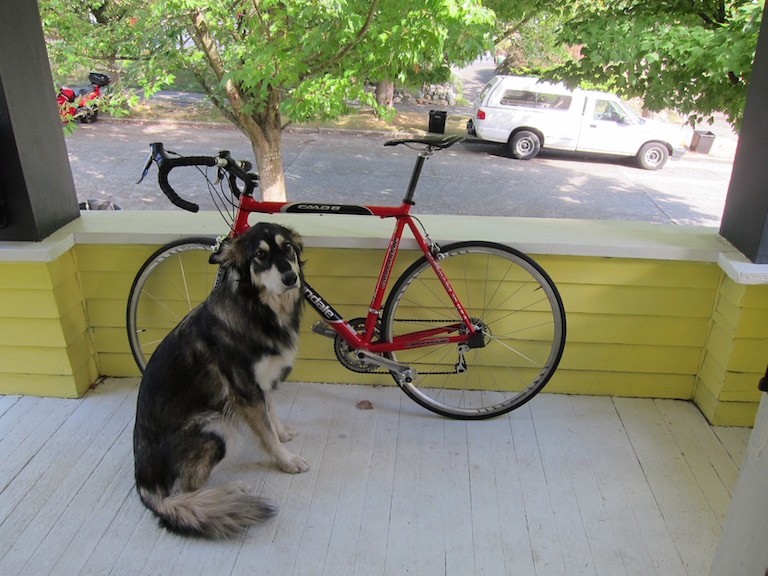

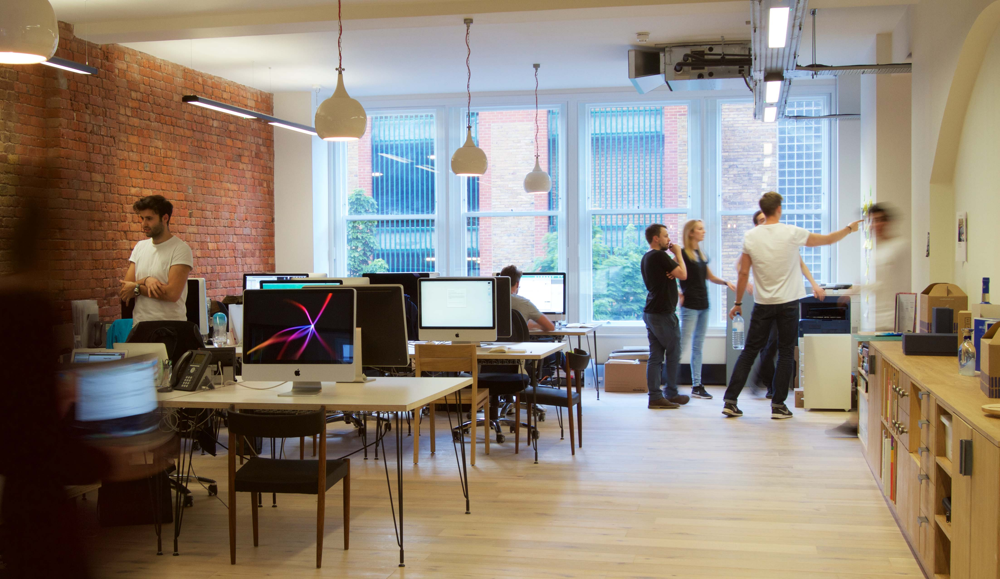

In [17]:
img_names = ["/content/drive/MyDrive/Data for Yolo v3 kernal/dog.jpg",
             "/content/drive/MyDrive/Data for Yolo v3 kernal/office.jpg"]
for img in img_names: display(Image.open(img))

*Detections*

In [18]:
!pip install Pillow==9.5.0 # Downgrade Pillow to a version containing the getsize method

Instructions for updating:
non-resource variables are not supported in the long term
Instructions for updating:
Use `tf.cast` instead.
Instructions for updating:
Use `tf.image.resize(...method=ResizeMethod.NEAREST_NEIGHBOR...)` instead.
<ipython-input-15-52b282e38ef0>:70: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_size = (draw.textlength(text, font=font), font.getsize(text)[1]) # textlength only provides width. getsize is used to get height


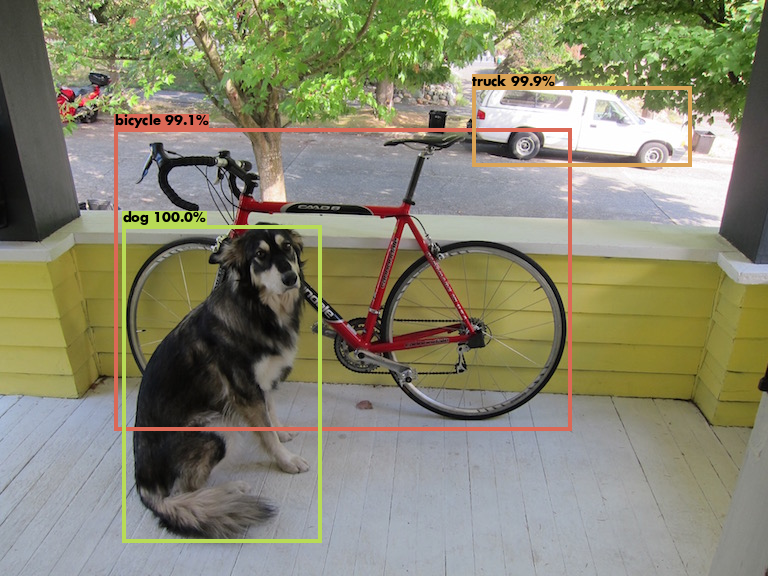

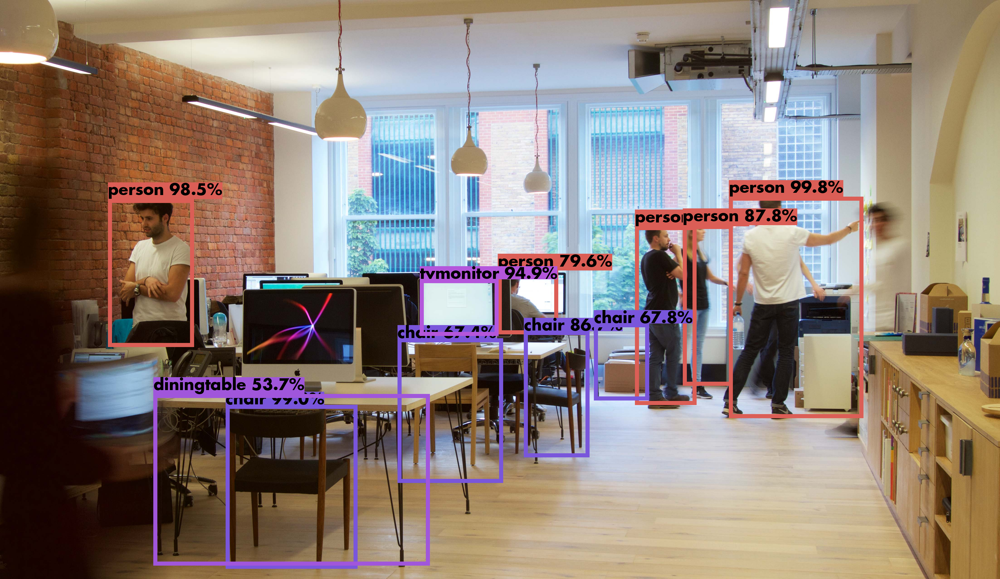

In [19]:
############################################
import tensorflow as tf
# Restrict tensorflow to version 1.x
if tf.__version__.startswith('2'):
  import tensorflow.compat.v1 as tf
  tf.disable_v2_behavior()


batch_size = len(img_names)
batch = load_images(img_names, model_size=_MODEL_SIZE)
class_names = load_class_names('/content/drive/MyDrive/Data for Yolo v3 kernal/coco.names')
n_classes = len(class_names)
max_output_size = 10
iou_threshold = 0.5
confidence_threshold = 0.5

# Explicitly specify data_format='channels_last' when creating the model
model = Yolo_v3(n_classes=n_classes, model_size=_MODEL_SIZE,
                max_output_size=max_output_size,
                iou_threshold=iou_threshold,
                confidence_threshold=confidence_threshold,
                data_format='channels_last')  # Force NHWC format

inputs = tf.zeros([batch_size, 416, 416, 3], dtype=tf.float32)

detections = model(inputs, training=False)

model_vars = tf.compat.v1.global_variables(scope='yolo_v3_model') # Use tf.compat.v1 for global_variables
assign_ops = load_weights(model_vars, '/content/drive/MyDrive/Data for Yolo v3 kernal/yolov3.weights')

# Instead of tf.function and sess, use tf.compat.v1.Session for TF1 compatibility
with tf.compat.v1.Session() as sess:
    sess.run(tf.compat.v1.global_variables_initializer()) # Initialize all variables before loading weights
    sess.run(assign_ops)
    detection_result = sess.run(detections, feed_dict={inputs: batch})

draw_boxes(img_names, detection_result, class_names, _MODEL_SIZE)